In [89]:
import pandas as pd

df = pd.read_csv(r'D:\covid_pro\WHO-COVID-19-global-daily-data.csv')
df

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
0,2020-01-04,NE,Niger,AFR,NaN,0,NaN,0
1,2020-01-04,NO,Norway,EUR,NaN,0,NaN,0
2,2020-01-04,PW,Palau,WPR,0.0,0,0.0,0
3,2020-01-04,PY,Paraguay,AMR,NaN,0,NaN,0
4,2020-01-04,PN,Pitcairn,WPR,0.0,0,0.0,0
...,...,...,...,...,...,...,...,...
487675,2025-07-27,BA,Bosnia and Herzegovina,EUR,NaN,404287,NaN,16406
487676,2025-07-27,CA,Canada,AMR,NaN,4819055,NaN,55282
487677,2025-07-27,BT,Bhutan,SEAR,NaN,63075,NaN,21
487678,2025-07-27,AZ,Azerbaijan,EUR,NaN,836510,NaN,10353


# Data inseption

In [90]:
df.duplicated().sum()

0

In [91]:
df.shape

(487680, 8)

In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 487680 entries, 0 to 487679
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Date_reported      487680 non-null  object 
 1   Country_code       485648 non-null  object 
 2   Country            487680 non-null  object 
 3   WHO_region         487680 non-null  object 
 4   New_cases          210274 non-null  float64
 5   Cumulative_cases   487680 non-null  int64  
 6   New_deaths         153909 non-null  float64
 7   Cumulative_deaths  487680 non-null  int64  
dtypes: float64(2), int64(2), object(4)
memory usage: 29.8+ MB


In [93]:
df.describe()

,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
count,2.102740e+05,4.876800e+05,153909.000000,4.876800e+05
mean,3.702112e+03,2.040467e+06,46.127095,2.164831e+04
std,4.857198e+04,8.511593e+06,242.408071,8.673084e+04
min,-6.507900e+04,0.000000e+00,-3520.000000,0.000000e+00
25%,3.000000e+00,6.589000e+03,0.000000,4.000000e+01
50%,6.100000e+01,5.900850e+04,2.000000,6.900000e+02
75%,6.770000e+02,6.608540e+05,15.000000,7.924000e+03
max,6.966046e+06,1.034368e+08,44047.000000,1.225927e+06


In [94]:
round(df.isna().mean(), 3) * 100

Date_reported         0.0
Country_code          0.4
Country               0.0
WHO_region            0.0
New_cases            56.9
Cumulative_cases      0.0
New_deaths           68.4
Cumulative_deaths     0.0
dtype: float64

In [95]:
df = df[
    (df['New_cases'].isna() | (df['New_cases'] >= 0)) &
    (df['New_deaths'].isna() | (df['New_deaths'] >= 0))
].reset_index(drop=True)

In [96]:
df.describe()

,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
count,2.101890e+05,4.875900e+05,153842.000000,4.875900e+05
mean,3.703456e+03,2.039895e+06,46.161503,2.164617e+04
std,4.858132e+04,8.508840e+06,242.011634,8.672048e+04
min,0.000000e+00,0.000000e+00,0.000000,0.000000e+00
25%,3.000000e+00,6.591000e+03,0.000000,4.000000e+01
50%,6.100000e+01,5.904800e+04,2.000000,6.900000e+02
75%,6.780000e+02,6.608540e+05,15.000000,7.925750e+03
max,6.966046e+06,1.034368e+08,44047.000000,1.225927e+06


In [97]:
# round(df.isna().mean(), 3) * 100

In [98]:
df = df.sort_values(["WHO_region","Country", "Date_reported"]).reset_index(drop=True)  
df

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
0,2020-01-04,DZ,Algeria,AFR,NaN,0,NaN,0
1,2020-01-05,DZ,Algeria,AFR,NaN,0,NaN,0
2,2020-01-06,DZ,Algeria,AFR,NaN,0,NaN,0
3,2020-01-07,DZ,Algeria,AFR,NaN,0,NaN,0
4,2020-01-08,DZ,Algeria,AFR,NaN,0,NaN,0
...,...,...,...,...,...,...,...,...
487585,2025-07-23,WF,Wallis and Futuna,WPR,NaN,3760,NaN,9
487586,2025-07-24,WF,Wallis and Futuna,WPR,NaN,3760,NaN,9
487587,2025-07-25,WF,Wallis and Futuna,WPR,NaN,3760,NaN,9
487588,2025-07-26,WF,Wallis and Futuna,WPR,NaN,3760,NaN,9


In [99]:
df[["New_cases", "New_deaths"]] = df[["New_cases", "New_deaths"]].fillna(0)

In [100]:
# to_drop = ['Country_code']
# df.drop(columns=to_drop, inplace=True)

In [101]:
round(df.isna().mean(), 3) * 100

Date_reported        0.0
Country_code         0.4
Country              0.0
WHO_region           0.0
New_cases            0.0
Cumulative_cases     0.0
New_deaths           0.0
Cumulative_deaths    0.0
dtype: float64

# Data Cleaning & feature eng

In [102]:
df.duplicated().sum()

0

In [103]:
df['Date_reported'] = pd.to_datetime(df['Date_reported'], format='%Y-%m-%d')
df['year'] = df['Date_reported'].dt.year
df

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths,year
0,2020-01-04,DZ,Algeria,AFR,0.0,0,0.0,0,2020
1,2020-01-05,DZ,Algeria,AFR,0.0,0,0.0,0,2020
2,2020-01-06,DZ,Algeria,AFR,0.0,0,0.0,0,2020
3,2020-01-07,DZ,Algeria,AFR,0.0,0,0.0,0,2020
4,2020-01-08,DZ,Algeria,AFR,0.0,0,0.0,0,2020
...,...,...,...,...,...,...,...,...,...
487585,2025-07-23,WF,Wallis and Futuna,WPR,0.0,3760,0.0,9,2025
487586,2025-07-24,WF,Wallis and Futuna,WPR,0.0,3760,0.0,9,2025
487587,2025-07-25,WF,Wallis and Futuna,WPR,0.0,3760,0.0,9,2025
487588,2025-07-26,WF,Wallis and Futuna,WPR,0.0,3760,0.0,9,2025


In [104]:
df.describe()

,Date_reported,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths,year
count,487590,4.875900e+05,4.875900e+05,487590.000000,4.875900e+05,487590.000000
mean,2022-10-15 13:28:44.978772736,1.596476e+03,2.039895e+06,14.564651,2.164617e+04,2022.310193
min,2020-01-04 00:00:00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,2020.000000
25%,2021-05-26 00:00:00,0.000000e+00,6.591000e+03,0.000000,4.000000e+01,2021.000000
50%,2022-10-16 00:00:00,0.000000e+00,5.904800e+04,0.000000,6.900000e+02,2022.000000
75%,2024-03-07 00:00:00,2.700000e+01,6.608540e+05,0.000000,7.925750e+03,2024.000000
max,2025-07-27 00:00:00,6.966046e+06,1.034368e+08,44047.000000,1.225927e+06,2025.000000
std,NaN,3.194943e+04,8.508840e+06,137.621648,8.672048e+04,1.618463


# Uni variate

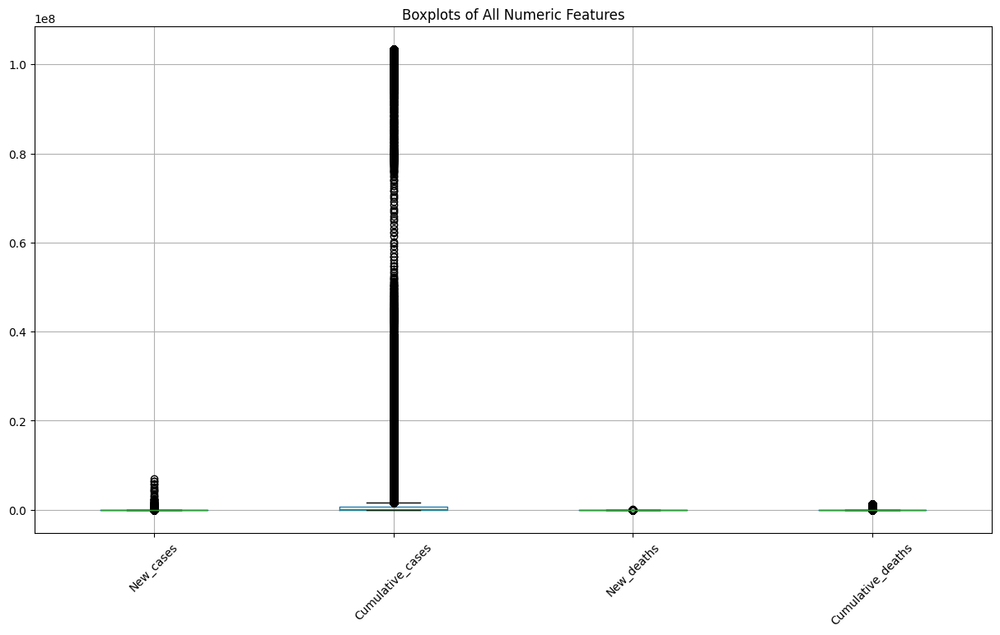

In [105]:
import matplotlib.pyplot as plt
import seaborn as sns

numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

plt.figure(figsize=(15, 8))
df[numeric_cols].boxplot()
plt.title("Boxplots of All Numeric Features")
plt.xticks(rotation=45)
plt.show()

# remove outliers in columns

In [106]:
# column_names = ['Cumulative_cases', 'Cumulative_deaths']
# for col in column_names:
#     q1 = df[col].quantile(0.25)
#     q3 = df[col].quantile(0.75)

#     iqr = q3 - q1

#     lower_bound = q1 - 3.0 * iqr
#     upper_bound = q3 + 3.0 * iqr
#     outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
#     df = df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]
#     print(f"Number of outliers in '{col}': {len(outliers)}")

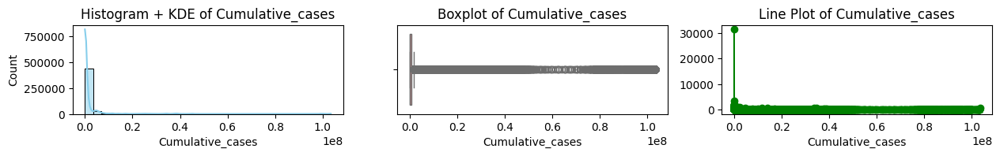

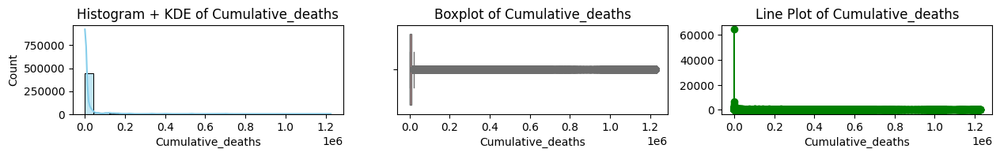

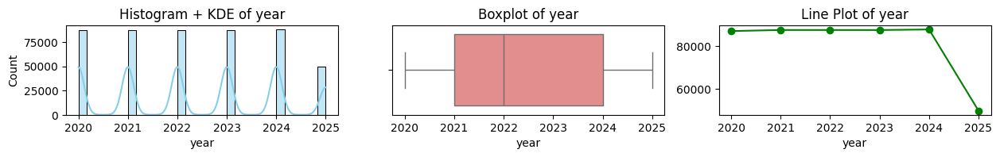

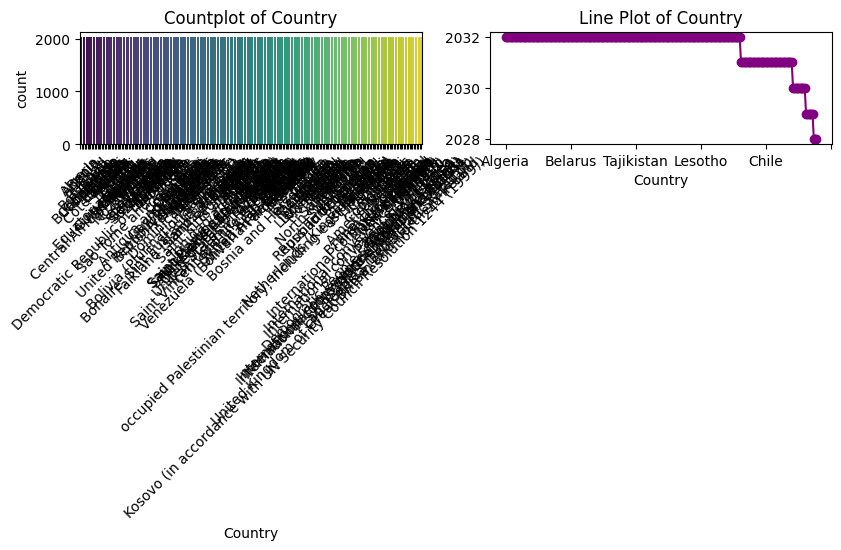

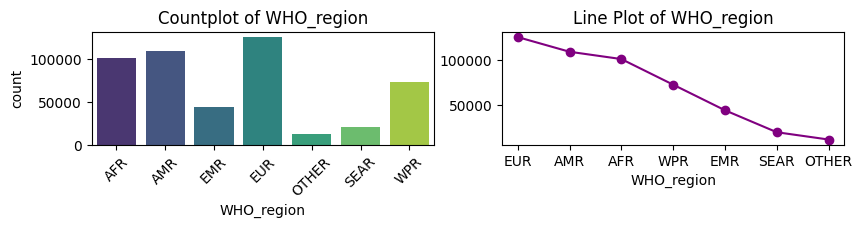

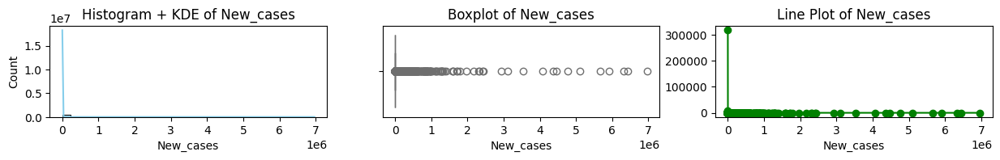

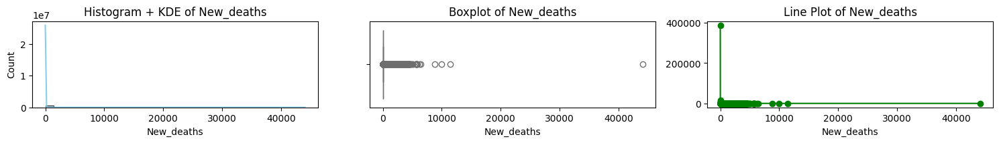

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns

cols = ["Cumulative_cases", "Cumulative_deaths", "year", "Country", "WHO_region", "New_cases", "New_deaths"]


for i, col in enumerate(cols, 1):
    if df[col].dtype != 'object':   # Numeric Features
        plt.figure(figsize=(15, 12))
        # Histogram + KDE
        plt.subplot(len(cols), 3, 3*(i-1)+1)
        sns.histplot(df[col].dropna(), bins=30, kde=True, color="skyblue", edgecolor="black")
        plt.title(f"Histogram + KDE of {col}")

        # Boxplot
        plt.subplot(len(cols), 3, 3*(i-1)+2)
        sns.boxplot(x=df[col], color="lightcoral")
        plt.title(f"Boxplot of {col}")

        # Line Plot (trend by sorted index)
        plt.subplot(len(cols), 3, 3*(i-1)+3)
        df[col].value_counts().sort_index().plot(kind="line", marker="o", color="green")
        plt.title(f"Line Plot of {col}")

    else:   # Categorical Features
        plt.figure(figsize=(15, 12))
        # Countplot
        plt.subplot(len(cols), 3, 3*(i-1)+1)
        # sns.countplot(x=df[col], palette="viridis", order=df[col].value_counts().index)
        sns.countplot(x=df[col], hue=df[col], palette="viridis", legend=False)
        plt.title(f"Countplot of {col}")
        plt.xticks(rotation=45)

        # Line Plot
        plt.subplot(len(cols), 3, 3*(i-1)+2)
        df[col].value_counts().plot(kind="line", marker="o", color="purple")
        plt.title(f"Line Plot of {col}")

plt.tight_layout()
plt.show()


# Bivariate

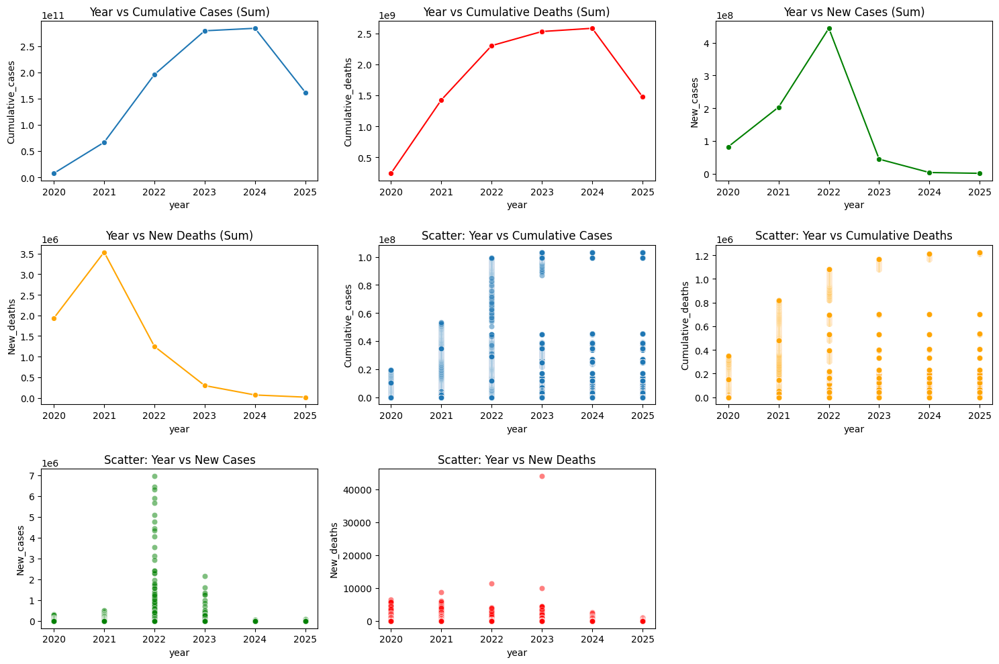

In [108]:
plt.figure(figsize=(15, 10))

# Line plot for Cumulative_cases
plt.subplot(3, 3, 1)
sns.lineplot(x="year", y="Cumulative_cases", data=df, estimator="sum", errorbar=None, marker="o")
plt.title("Year vs Cumulative Cases (Sum)")

# Line plot for Cumulative_deaths
plt.subplot(3, 3, 2)
sns.lineplot(x="year", y="Cumulative_deaths", data=df, estimator="sum", errorbar=None, marker="o", color="red")
plt.title("Year vs Cumulative Deaths (Sum)")

# line plot for New_cases
plt.subplot(3, 3, 3)
sns.lineplot(x="year", y="New_cases", data=df, estimator="sum", errorbar=None, marker="o", color="green")
plt.title("Year vs New Cases (Sum)")

# line plot for New_deaths
plt.subplot(3, 3, 4)
sns.lineplot(x="year", y="New_deaths", data=df, estimator="sum", errorbar=None, marker="o", color="orange")
plt.title("Year vs New Deaths (Sum)")

# Scatter plot for Cumulative_cases
plt.subplot(3, 3, 5)
sns.scatterplot(x="year", y="Cumulative_cases", data=df, alpha=0.5)
plt.title("Scatter: Year vs Cumulative Cases")

# Scatter plot for Cumulative_deaths
plt.subplot(3, 3, 6)
sns.scatterplot(x="year", y="Cumulative_deaths", data=df, alpha=0.5, color="orange")
plt.title("Scatter: Year vs Cumulative Deaths")

# Scatter plot for New_cases
plt.subplot(3, 3, 7)
sns.scatterplot(x="year", y="New_cases", data=df, alpha=0.5, color="green")
plt.title("Scatter: Year vs New Cases")

# Scatter plot for New_deaths
plt.subplot(3, 3, 8)
sns.scatterplot(x="year", y="New_deaths", data=df, alpha=0.5, color="red")
plt.title("Scatter: Year vs New Deaths")

plt.tight_layout()
plt.show()


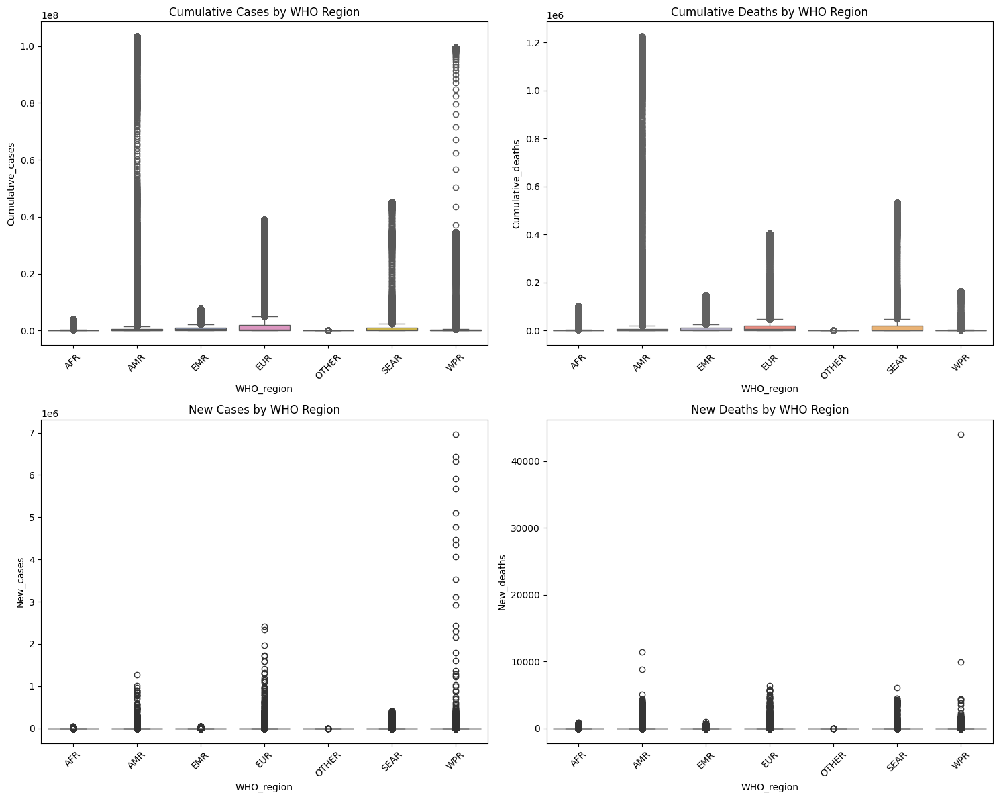

In [109]:
plt.figure(figsize=(15, 12))

# Boxplot for Cumulative_cases by WHO_region
plt.subplot(2, 2, 1)
sns.boxplot(x="WHO_region", y="Cumulative_cases", data=df, hue="WHO_region", palette="Set2", legend=False)
plt.title("Cumulative Cases by WHO Region")
plt.xticks(rotation=45)

# Boxplot for Cumulative_deaths by WHO_region
plt.subplot(2, 2, 2)
sns.boxplot(x="WHO_region", y="Cumulative_deaths", data=df, hue="WHO_region", palette="Set3", legend=False)
plt.title("Cumulative Deaths by WHO Region")
plt.xticks(rotation=45)

# boxplot for New_cases by WHO_region
plt.subplot(2, 2, 3)
sns.boxplot(x="WHO_region", y="New_cases", data=df, hue="WHO_region", palette="Blues", legend=False)
plt.title("New Cases by WHO Region")
plt.xticks(rotation=45)

# boxplot for New_deaths by WHO_region
plt.subplot(2, 2, 4)
sns.boxplot(x="WHO_region", y="New_deaths", data=df, hue="WHO_region", palette="Reds", legend=False)
plt.title("New Deaths by WHO Region")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

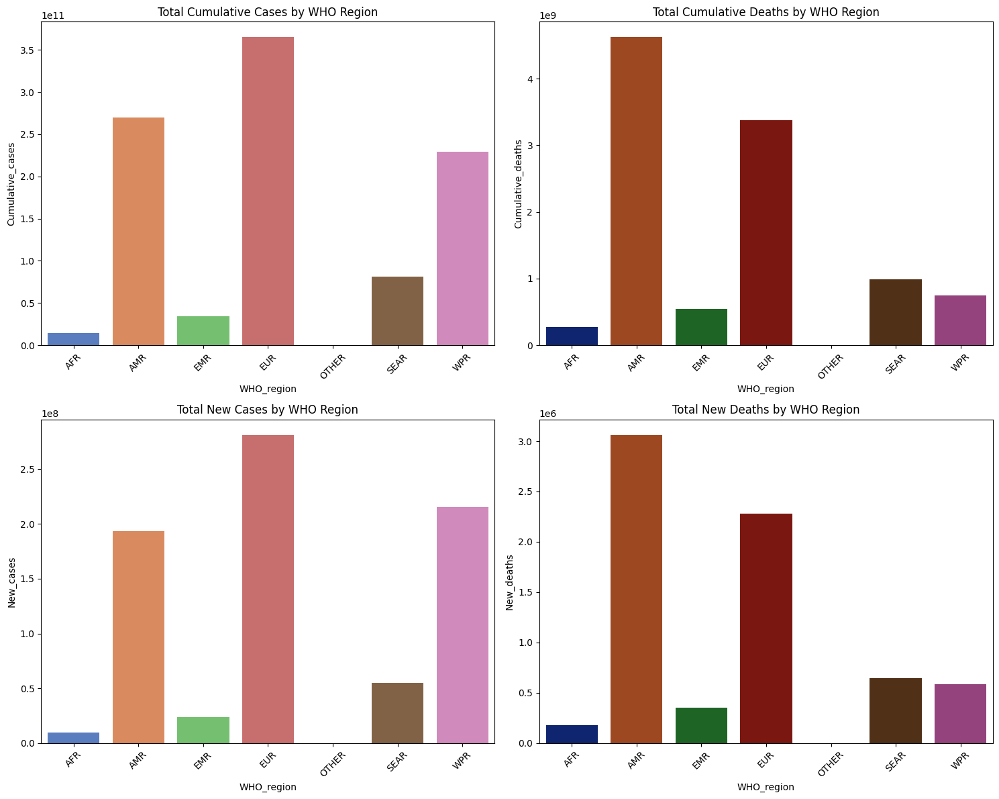

In [110]:
plt.figure(figsize=(15, 12))

# Barplot (sum) for Cumulative_cases
plt.subplot(2, 2, 1)
sns.barplot(x="WHO_region", y="Cumulative_cases", data=df, estimator="sum", errorbar=None,
            hue="WHO_region", palette="muted", legend=False)
plt.title("Total Cumulative Cases by WHO Region")
plt.xticks(rotation=45)

# Barplot (sum) for Cumulative_deaths
plt.subplot(2, 2, 2)
sns.barplot(x="WHO_region", y="Cumulative_deaths", data=df, estimator="sum", errorbar=None,
            hue="WHO_region", palette="dark", legend=False)
plt.title("Total Cumulative Deaths by WHO Region")
plt.xticks(rotation=45)

# barplot (sum) for New_cases
plt.subplot(2, 2, 3)
sns.barplot(x="WHO_region", y="New_cases", data=df, estimator="sum", errorbar=None,
            hue="WHO_region", palette="muted", legend=False)
plt.title("Total New Cases by WHO Region")
plt.xticks(rotation=45)

# barplot (sum) for New_deaths
plt.subplot(2, 2, 4)
sns.barplot(x="WHO_region", y="New_deaths", data=df, estimator="sum", errorbar=None,
            hue="WHO_region", palette="dark", legend=False)
plt.title("Total New Deaths by WHO Region")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

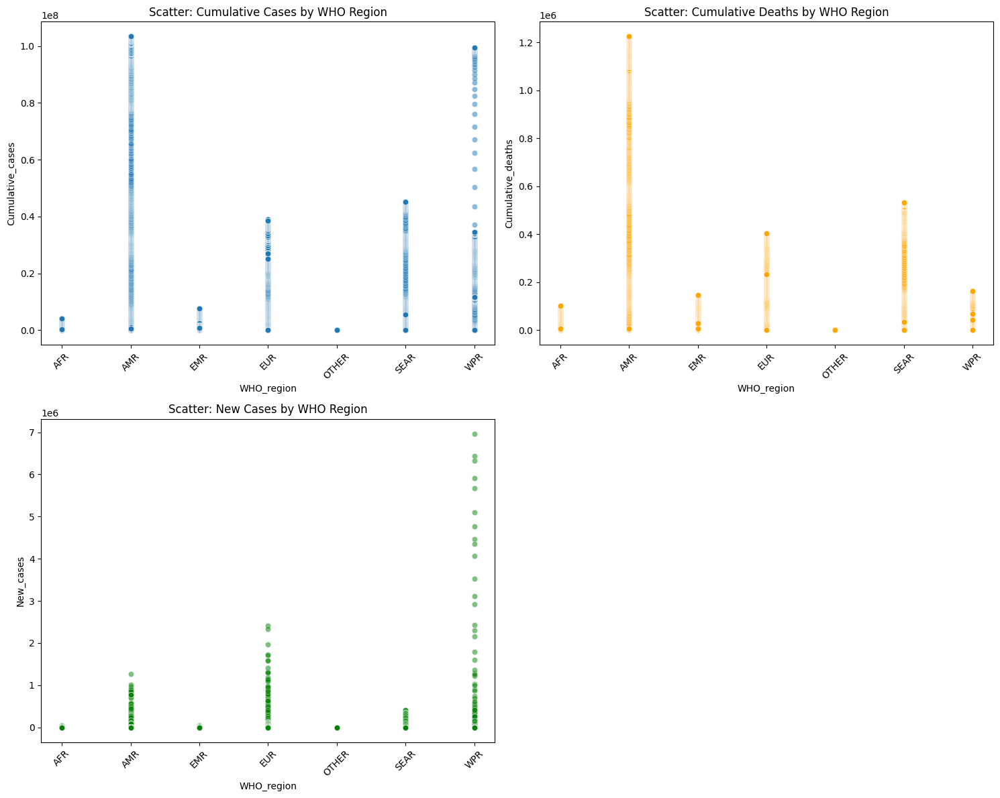

In [111]:
plt.figure(figsize=(15, 12))

# scatter plot for Cumulative_cases by WHO_region
plt.subplot(2, 2, 1)
sns.scatterplot(x="WHO_region", y="Cumulative_cases", data=df, alpha=0.5)
plt.title("Scatter: Cumulative Cases by WHO Region")
plt.xticks(rotation=45)

# scatter plot for Cumulative_deaths by WHO_region
plt.subplot(2, 2, 2)
sns.scatterplot(x="WHO_region", y="Cumulative_deaths", data=df, alpha=0.5, color="orange")
plt.title("Scatter: Cumulative Deaths by WHO Region")
plt.xticks(rotation=45)

# scatter plot for New_cases by WHO_region
plt.subplot(2, 2, 3)
sns.scatterplot(x="WHO_region", y="New_cases", data=df, alpha=0.5, color="green")
plt.title("Scatter: New Cases by WHO Region")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

# Multivariate 

In [112]:
agg_df = df.groupby(['WHO_region', 'year'])[['Cumulative_cases', 'Cumulative_deaths']].mean().reset_index()

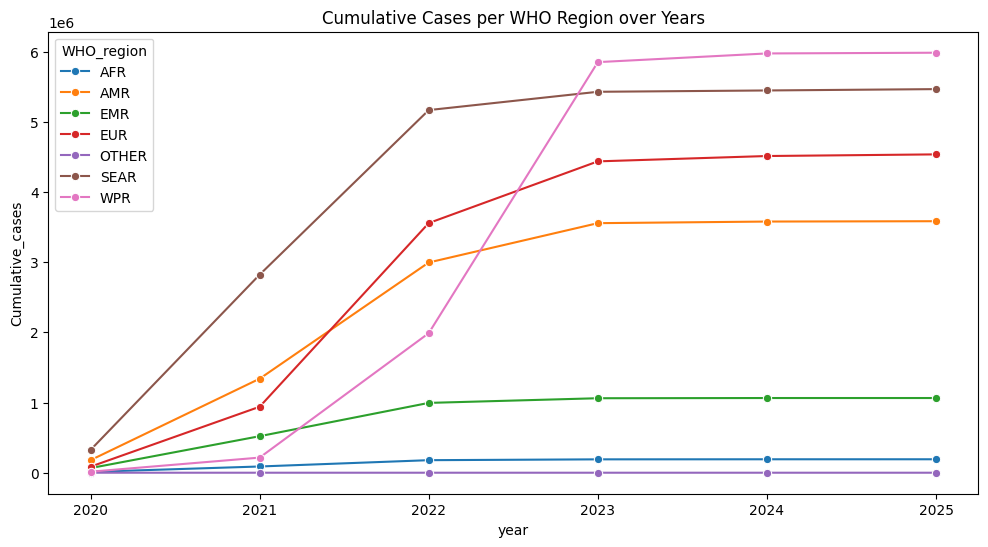

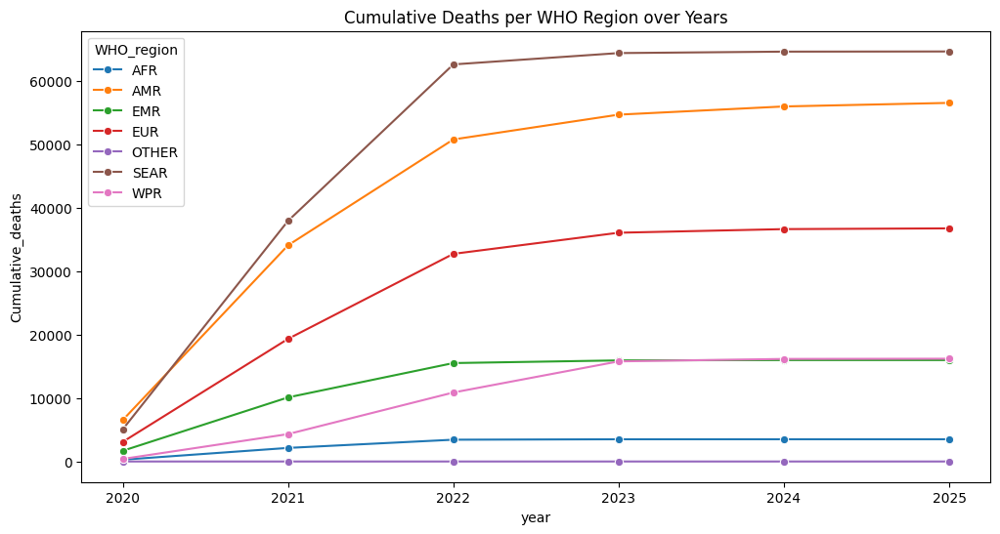

In [113]:
plt.figure(figsize=(12,6))
sns.lineplot(x="year", y="Cumulative_cases", hue="WHO_region", data=agg_df, marker="o")
plt.title("Cumulative Cases per WHO Region over Years")
plt.show()

plt.figure(figsize=(12,6))
sns.lineplot(x="year", y="Cumulative_deaths", hue="WHO_region", data=agg_df, marker="o")
plt.title("Cumulative Deaths per WHO Region over Years")
plt.show()

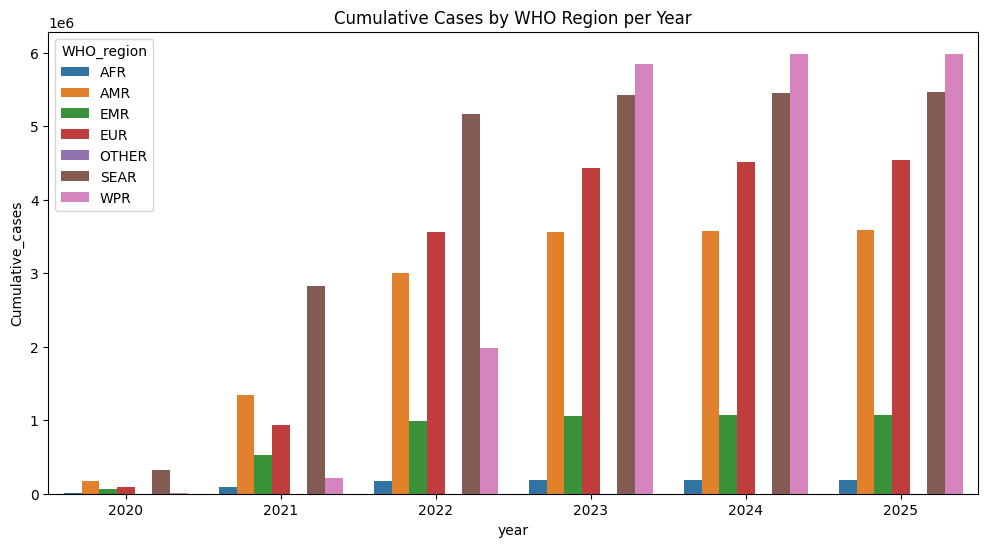

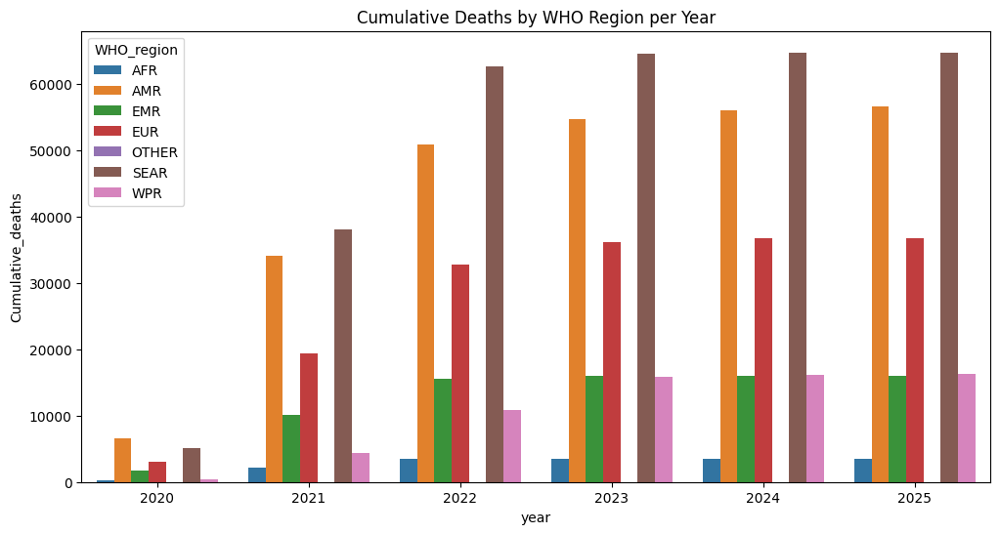

In [114]:
plt.figure(figsize=(12,6))
sns.barplot(x="year", y="Cumulative_cases", hue="WHO_region", data=agg_df, estimator="mean", errorbar=None)
plt.title("Cumulative Cases by WHO Region per Year")
plt.show()

plt.figure(figsize=(12,6))
sns.barplot(x="year", y="Cumulative_deaths", hue="WHO_region", data=agg_df, estimator="mean", errorbar=None)
plt.title("Cumulative Deaths by WHO Region per Year")
plt.show()

In [115]:
agg_df_for_new = df.groupby(['WHO_region', 'year'])[['New_cases', 'New_deaths']].mean().reset_index()

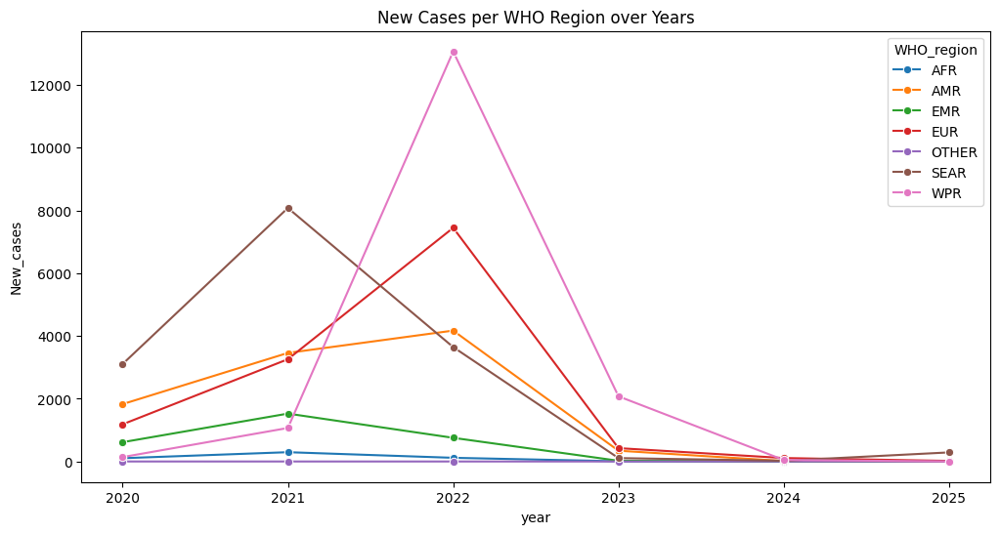

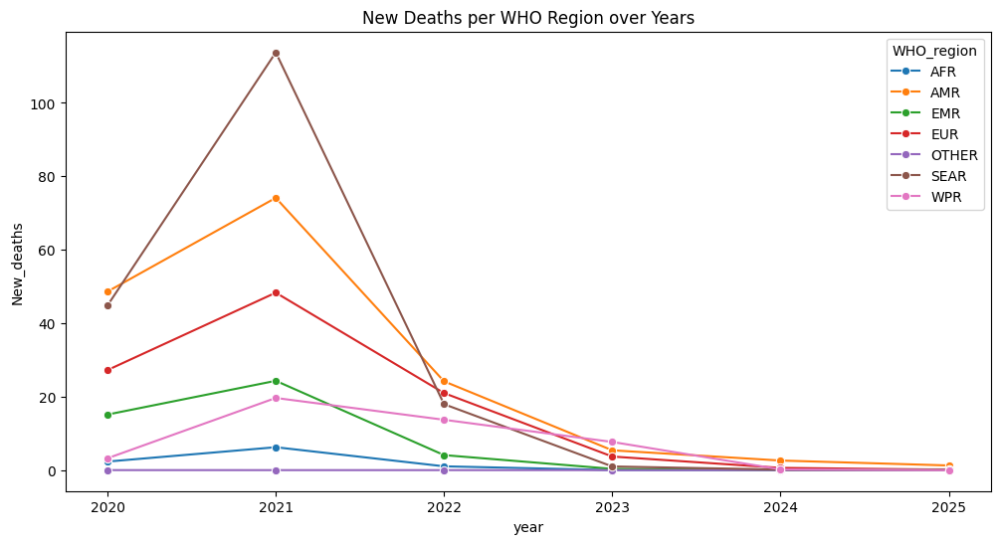

In [116]:
plt.figure(figsize=(12,6))
sns.lineplot(x="year", y="New_cases", hue="WHO_region", data=agg_df_for_new, marker="o")
plt.title("New Cases per WHO Region over Years")
plt.show()

plt.figure(figsize=(12,6))
sns.lineplot(x="year", y="New_deaths", hue="WHO_region", data=agg_df_for_new, marker="o")
plt.title("New Deaths per WHO Region over Years")
plt.show()

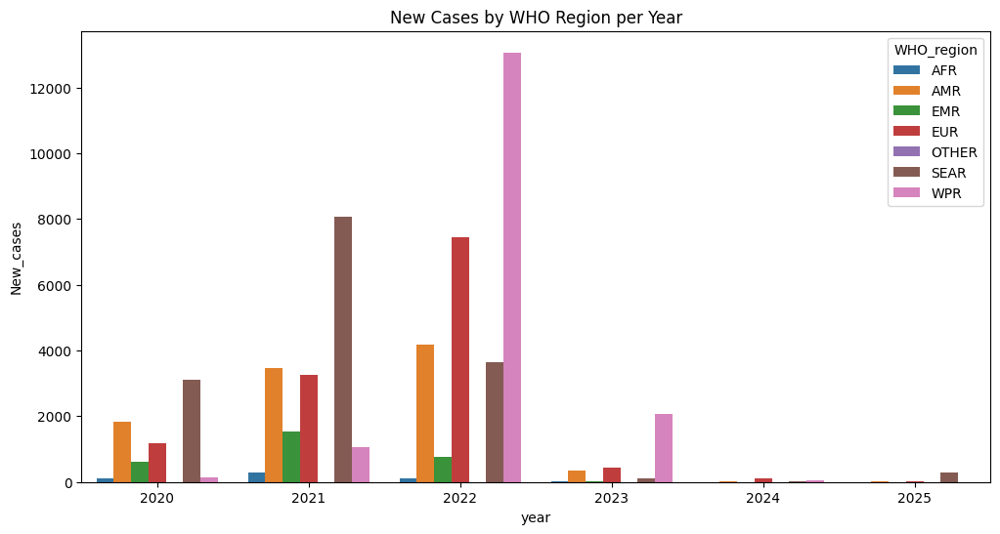

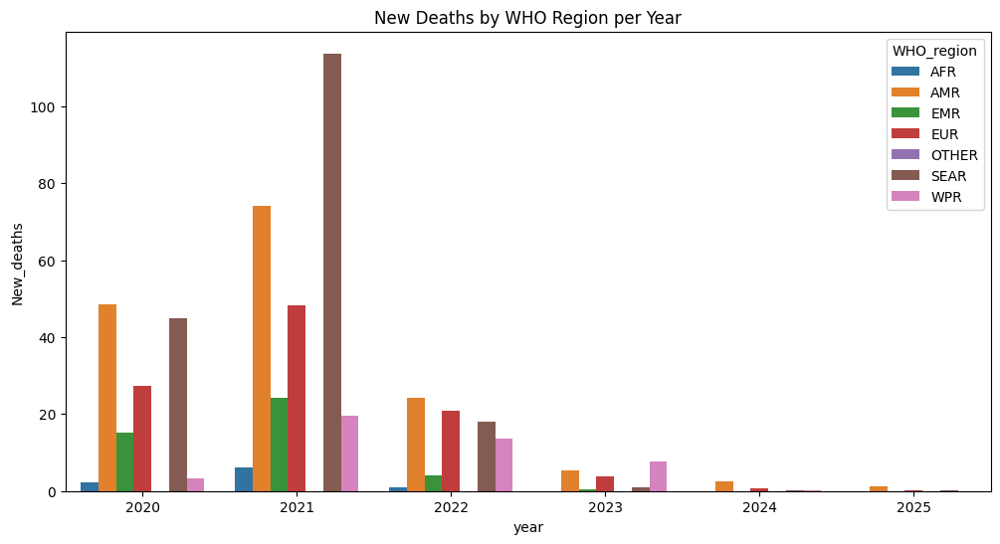

In [117]:
plt.figure(figsize=(12,6))
sns.barplot(x="year", y="New_cases", hue="WHO_region", data=agg_df_for_new, estimator="mean", errorbar=None)
plt.title("New Cases by WHO Region per Year")
plt.show()

plt.figure(figsize=(12,6))
sns.barplot(x="year", y="New_deaths", hue="WHO_region", data=agg_df_for_new, estimator="mean", errorbar=None)
plt.title("New Deaths by WHO Region per Year")
plt.show()

#  Plotly Maps in Visualization

In [122]:
import pycountry

def iso3(code):
    try:
        return pycountry.countries.lookup(code).alpha_3
    except:
        return None

df["Country_code"] = df["Country_code"].apply(iso3)

In [ ]:
import plotly.express as px

fig = px.choropleth(
    df,
    locations="Country_code",           
    color="New_cases",                  
    hover_name="Country",               
    animation_frame="year",              
    color_continuous_scale="Reds",     
    projection="natural earth",        
    title="WHO COVID-19 New Cases per Country over Years"
)

fig.show()